<a href="https://colab.research.google.com/github/l-isaro/Activity_image-processing/blob/main/FashionMNIST_Image_Processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# FashionMNIST & Custom Image Processing

**Members **


1.   Ivan Shema
2.   Leslie Isaro



In [ ]:
# ↳ Install packages (uncomment if Colab cannot find them)
# !pip install tensorflow tensorflow-datasets opencv-python matplotlib --quiet

import tensorflow as tf
import tensorflow_datasets as tfds
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

print("TensorFlow version:", tf.__version__)


TensorFlow version: 2.18.0


## 1. Load FashionMNIST Dataset

In [ ]:
# Load the FashionMNIST training split
ds = tfds.load('fashion_mnist', split='train', as_supervised=True)
images, labels = zip(*list(ds.take(1000)))  # Take a subset for speed
print(f"Loaded {len(images)} images")


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/fashion_mnist/incomplete.2MDLNR_3.0.1/fashion_mnist-train.tfrecord*...:   …

Generating test examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/fashion_mnist/incomplete.2MDLNR_3.0.1/fashion_mnist-test.tfrecord*...:   0…

Dataset fashion_mnist downloaded and prepared to /root/tensorflow_datasets/fashion_mnist/3.0.1. Subsequent calls will reuse this data.
Loaded 1000 images


## 2. Load & Display a Custom Image

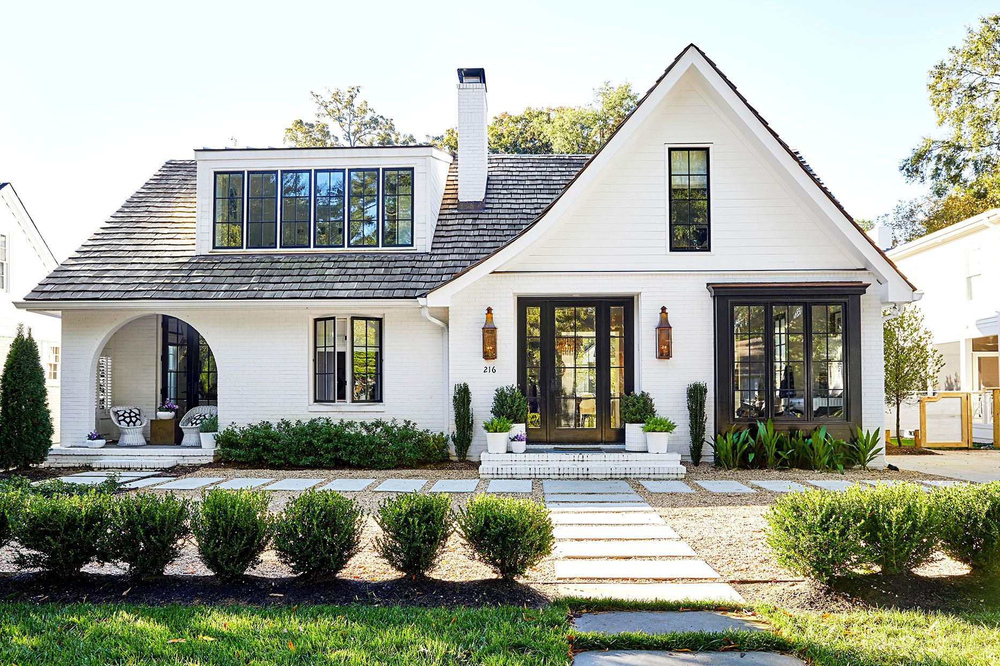

Image shape: (1244, 1866, 3)


In [ ]:
#@title Choose a file ↘️ {display-mode: "form"}
image_path = "/content/white-house-a-frame-section.jpg"  # ← replace with your own

img = cv2.imread(image_path)
if img is None:
    raise FileNotFoundError(f"Could not load image from {image_path}. "
                            "Check the path and try again.")
cv2_imshow(img)
print("Image shape:", img.shape)


## 3. Apply a 3×3 Averaging Filter

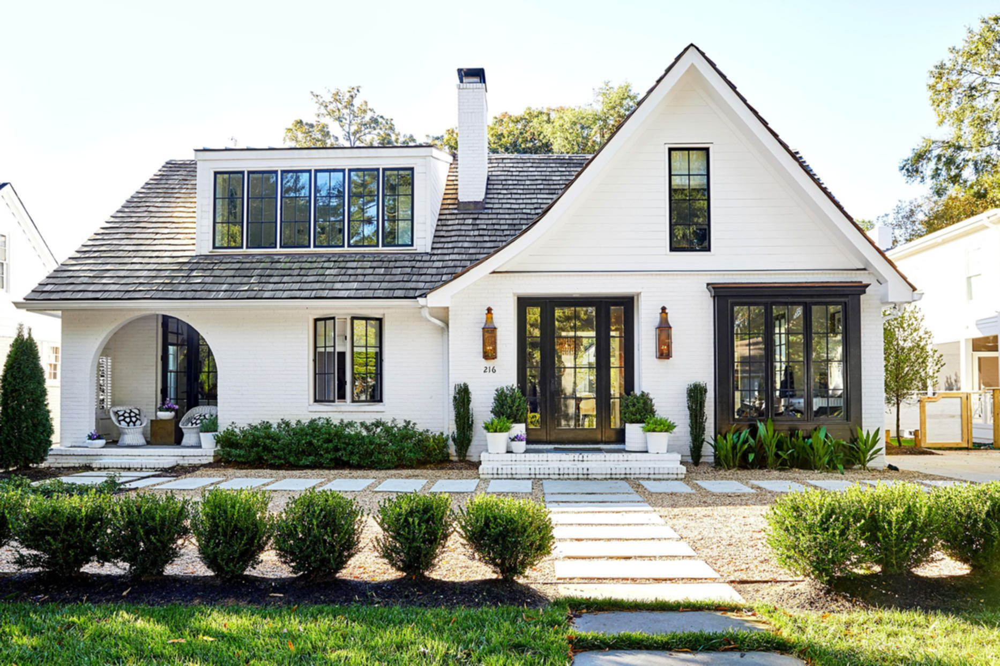

In [ ]:
kernel = np.ones((3, 3), np.float32) / 9
averaged = cv2.filter2D(img, -1, kernel)
cv2_imshow(averaged)


## 4. Flip Images Vertically & Horizontally

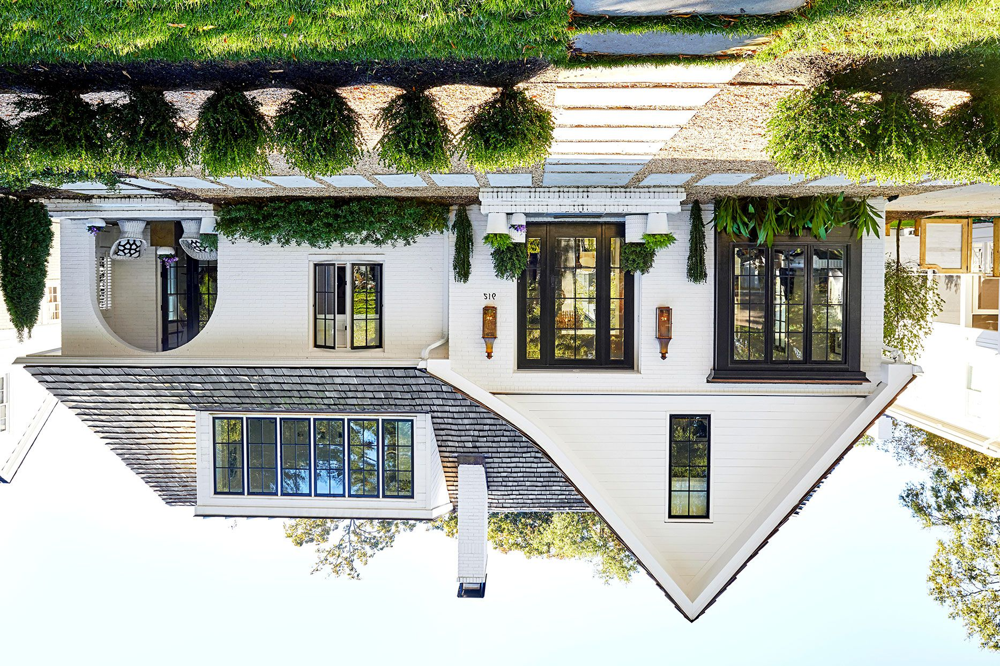

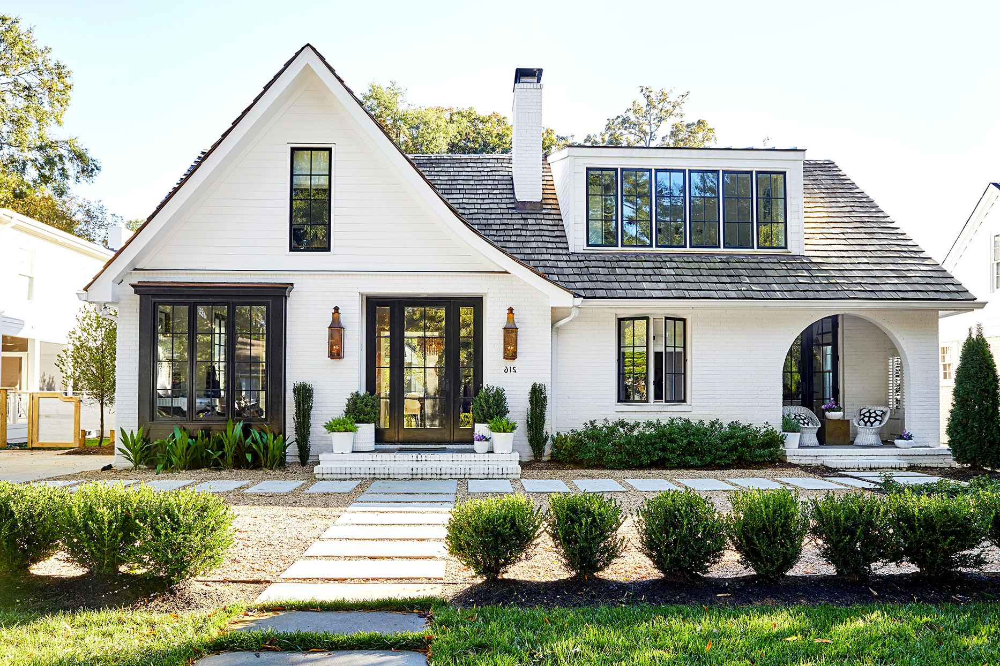

In [ ]:
v_flip = cv2.flip(img, 0)  # Vertical flip
h_flip = cv2.flip(img, 1)  # Horizontal flip

cv2_imshow(v_flip)
cv2_imshow(h_flip)


## 5. Gaussian Blur

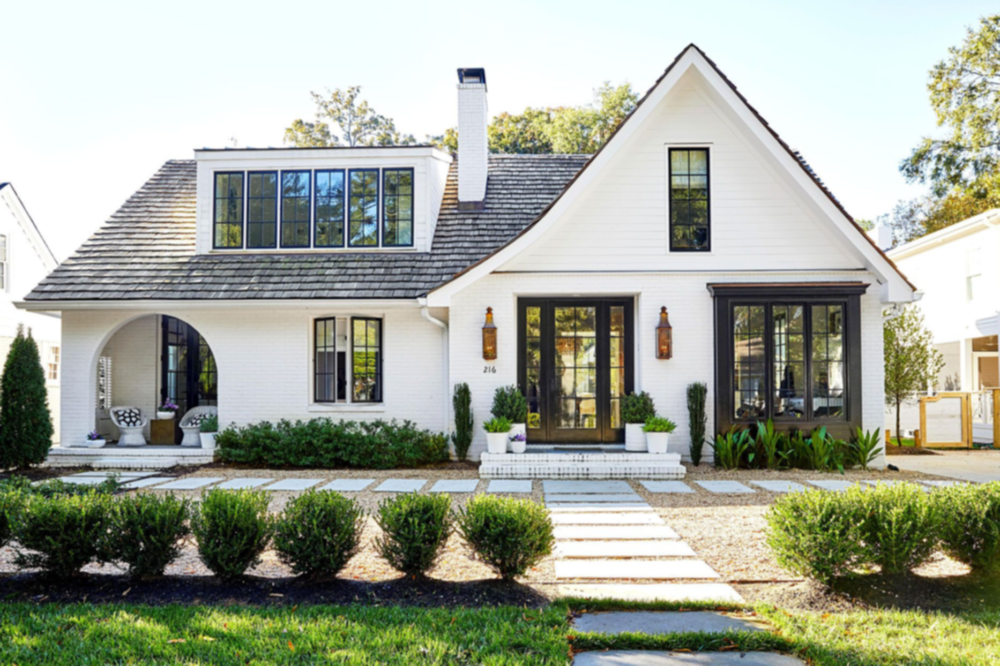

In [ ]:
blurred = cv2.GaussianBlur(img, (5, 5), sigmaX=1.5)
cv2_imshow(blurred)


## 6. Adjust Brightness & Contrast

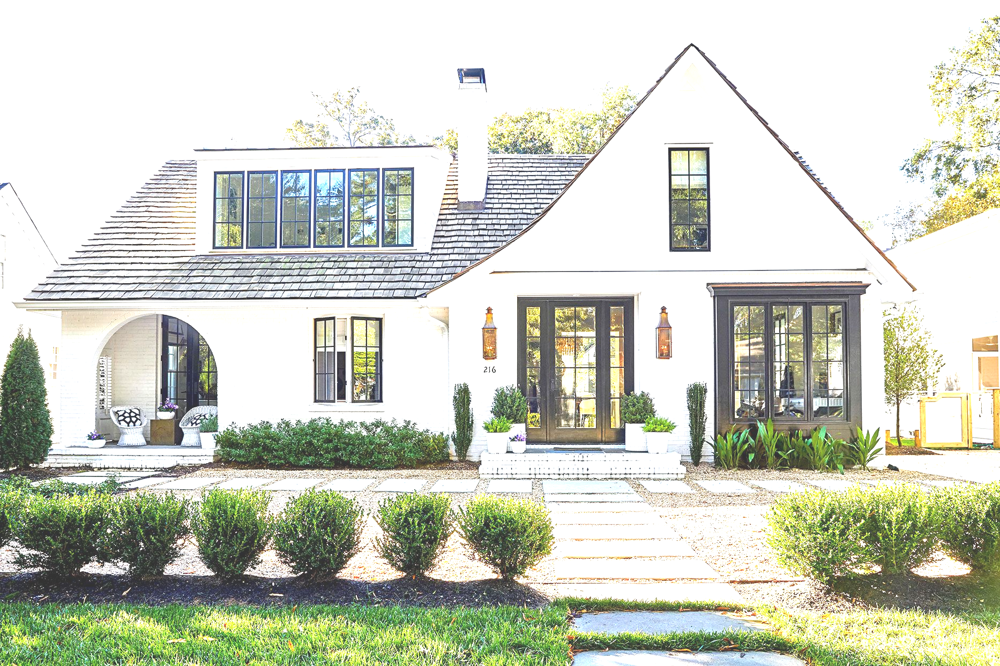

In [ ]:
bright = cv2.convertScaleAbs(img, alpha=1.2, beta=50)  # α = contrast, β = brightness
cv2_imshow(bright)


## 7. Random Rotation

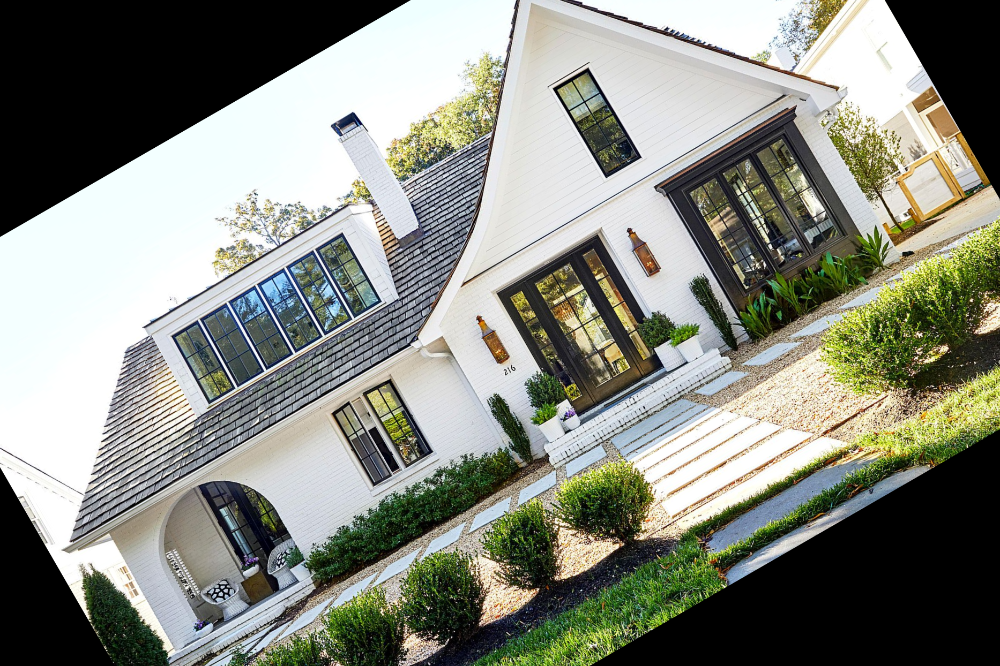

In [ ]:
rows, cols = img.shape[:2]
M = cv2.getRotationMatrix2D((cols / 2, rows / 2), angle=30, scale=1.0)
rotated = cv2.warpAffine(img, M, (cols, rows))
cv2_imshow(rotated)


## 8. Challenge: End‑to‑End Pipeline on FashionMNIST
Convert a sample FashionMNIST tensor to a NumPy array, resize it, apply each transformation, and display the results in a grid.

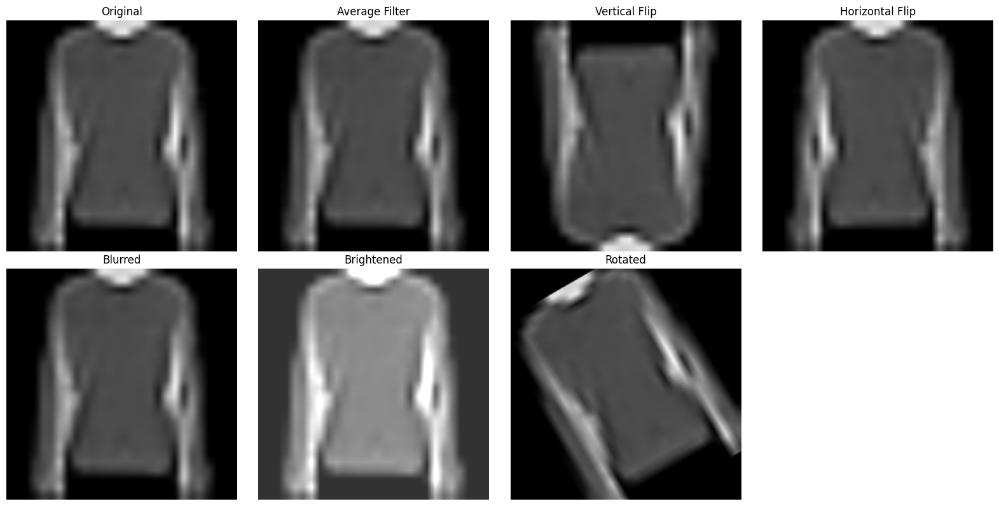

In [ ]:
# Select the first sample
sample = images[0].numpy()  # shape (28, 28)

# Resize to 224×224 and convert to 3‑channel BGR
resized = cv2.resize(sample, (224, 224))
img_mnist = cv2.cvtColor(resized, cv2.COLOR_GRAY2BGR)

# Apply the same transformations
average_mnist = cv2.filter2D(img_mnist, -1, kernel)
v_flip_mnist = cv2.flip(img_mnist, 0)
h_flip_mnist = cv2.flip(img_mnist, 1)
blurred_mnist = cv2.GaussianBlur(img_mnist, (5, 5), sigmaX=1.5)
bright_mnist = cv2.convertScaleAbs(img_mnist, alpha=1.2, beta=50)
M_mnist = cv2.getRotationMatrix2D((112, 112), angle=30, scale=1.0)
rotated_mnist = cv2.warpAffine(img_mnist, M_mnist, (224, 224))

# Display
images_to_show = [
    img_mnist,
    average_mnist,
    v_flip_mnist,
    h_flip_mnist,
    blurred_mnist,
    bright_mnist,
    rotated_mnist,
]
titles = [
    "Original",
    "Average Filter",
    "Vertical Flip",
    "Horizontal Flip",
    "Blurred",
    "Brightened",
    "Rotated",
]

plt.figure(figsize=(16, 8))
for i, (im, title) in enumerate(zip(images_to_show, titles)):
    plt.subplot(2, 4, i + 1)
    plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis("off")
plt.tight_layout()
plt.show()
